<a href="https://colab.research.google.com/github/GRT27/Detection-Models-Comparison/blob/main/SateliteImageSegment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import kagglehub

# Download the dataset
path = kagglehub.dataset_download("kmader/synthetic-word-ocr")

# Print the path where the dataset is saved locally
print("Path to dataset files:", path)


100%|██████████| 3.93G/3.93G [00:50<00:00, 82.8MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/kmader/synthetic-word-ocr/versions/1


In [2]:
import numpy
import json
import pandas as pd
import os
import matplotlib.pyplot as plt
from skimage.io import imread
from matplotlib.collections import PatchCollection
from matplotlib.patches import Rectangle
import numpy as np
from sklearn.model_selection import train_test_split
from PIL import Image
from skimage.util import montage

In [3]:
# Assuming the dataset is downloaded at the given path
dataset_dir = path
images_dir = os.path.join(dataset_dir, "train/images/")
annotations_path = os.path.join(dataset_dir, "annotation.json")

# Load annotations
with open(annotations_path, 'r') as f:
    annotations = json.load(f)


# Print the first few keys to inspect the structure of the data
print(annotations.keys())

# Print out a sample entry to understand its structure
print(json.dumps(annotations['images'][0], indent=2))

dict_keys(['info', 'categories', 'images', 'annotations'])
{
  "id": 239047,
  "file_name": "000000239047.jpg",
  "width": 300,
  "height": 300
}


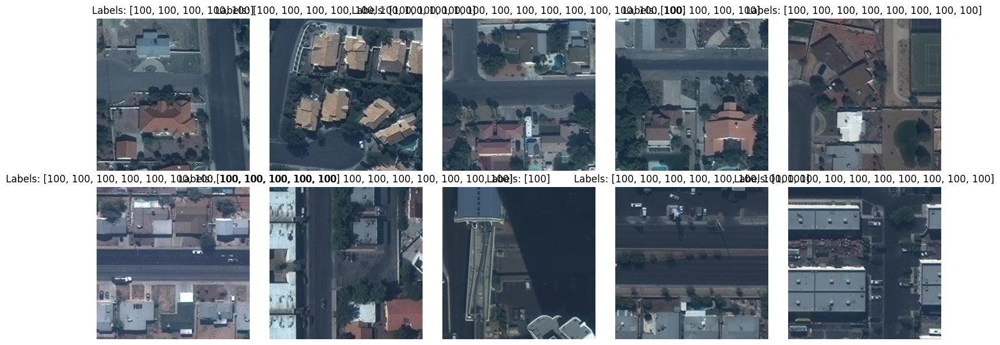

In [4]:

# Extract image paths and labels from the annotations
image_paths = [os.path.join(images_dir, image['file_name']) for image in annotations['images']]

# Create a mapping from image_id to category labels
image_labels = {}
for annotation in annotations['annotations']:
    image_id = annotation['image_id']
    category_id = annotation['category_id']

    if image_id not in image_labels:
        image_labels[image_id] = []
    image_labels[image_id].append(category_id)

# Plot the images with their respective labels (only top 10 images)
fig, axes = plt.subplots(2, 5, figsize=(15, 6))  # 2x5 grid for 10 images
axes = axes.flatten()  # Flatten the 2D axes array for easier indexing

# Loop through the first 10 images
for i, (image_info, ax) in enumerate(zip(annotations['images'][:10], axes)):
    image_id = image_info['id']
    file_name = image_info['file_name']

    # Load the image
    img_path = os.path.join(images_dir, file_name)
    img = Image.open(img_path)

    # Get the labels for the current image (category IDs)
    labels = image_labels.get(image_id, [])

    # Display the image
    ax.imshow(img)
    ax.axis('off')

    # Show the labels as text on the image
    ax.set_title(f"Labels: {labels}")

# Adjust layout and show the plot
plt.tight_layout()
plt.show()



            id         file_name  width  height
42821   123259  000000123259.jpg    300     300
67260   241755  000000241755.jpg    300     300
271841  200134  000000200134.jpg    300     300
             id  image_id                                       segmentation  \
934493    83020      9818  [[96, 56, 96, 71, 69, 72, 68, 56, 44, 56, 44, ...   
1287528  819846     96167  [[229.0, 136.0, 250.0, 137.0, 249.0, 163.0, 22...   
1627585  930829    109306  [[131.0, 149.0, 119.0, 148.0, 120.0, 138.0, 13...   

           area                         bbox  category_id  iscrowd  
934493   2875.0             [44, 44, 52, 52]          100        0  
1287528   544.0  [136.0, 229.0, 114.0, 21.0]          100        0  
1627585   121.0   [119.0, 119.0, 30.0, 12.0]          100        0  
280741 + 2395553 -> 2395553
            id_x  image_id                                       segmentation  \
1799709  1473042    172795  [[106.0, 2.6942229581241772e-15, 104.0, 3.0000...   
249836   2340396    2

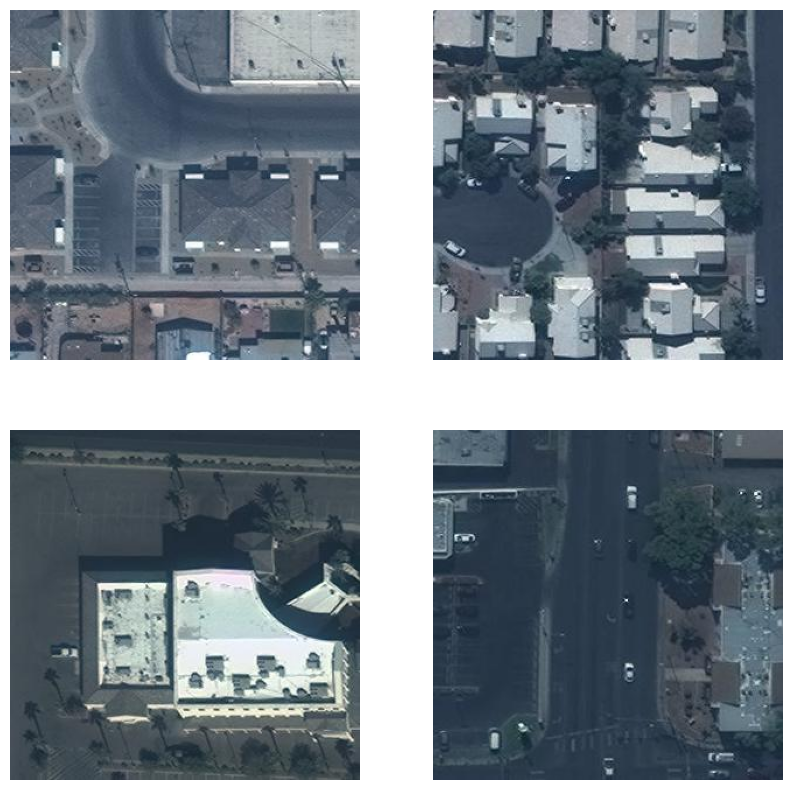

In [5]:
# Step 1: Create image_df from the 'images' part of annotations
image_df = pd.DataFrame(annotations['images'])
print(image_df.sample(3))

# Step 2: Display sample images
fig, m_axs = plt.subplots(2, 2, figsize=(10, 10))
for c_ax, (_, c_row) in zip(m_axs.flatten(), image_df.sample(4).iterrows()):
    img_data = imread(os.path.join(images_dir, c_row['file_name']))  # Path to images directory
    c_ax.imshow(img_data)
    c_ax.axis('off')  # Turn off axes for clearer view of images

# Step 3: Create annot_df from the 'annotations' part of the data
annot_df = pd.DataFrame(annotations['annotations'])
print(annot_df.sample(3))

# Step 4: Merge annot_df and image_df on image_id and id, then drop missing values
full_df = pd.merge(annot_df, image_df, how='left', left_on='image_id', right_on='id').dropna()

# Step 5: Print out the shapes of the DataFrames and a sample of the full merged DataFrame
print(f"{image_df.shape[0]} + {annot_df.shape[0]} -> {full_df.shape[0]}")
print(full_df.sample(2))

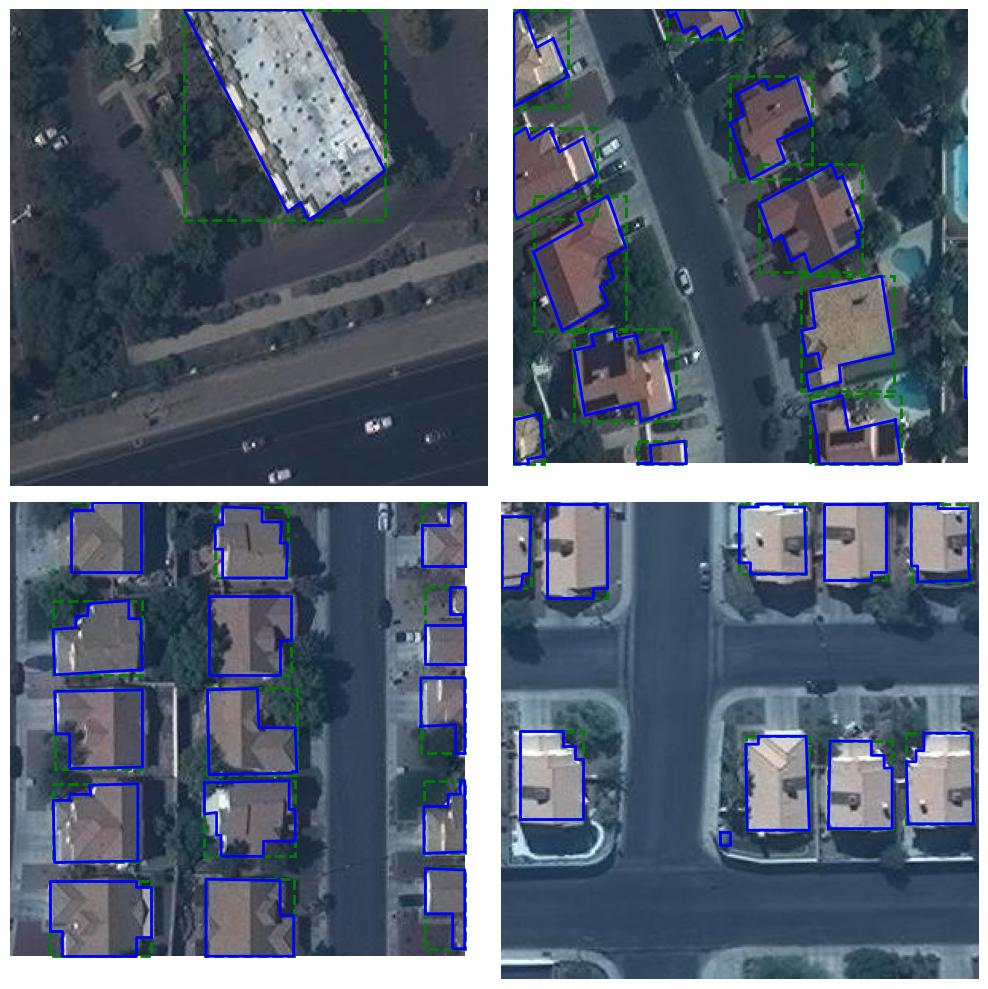

In [6]:
# Define a function to create bounding boxes based on the segmentation polygon
def create_boxes(in_rows):
    box_list = []
    for _, in_row in in_rows.iterrows():
        # bbox from the COCO standard (min/max coordinates)
        (start_y, start_x, wid_y, wid_x) = in_row['bbox']

        # Create rectangle for bounding box (adjust to house)
        box_list.append(Rectangle((start_x, start_y), wid_x, wid_y, linewidth=2, edgecolor='r', facecolor='none'))
    return box_list

# Step 5: Plot images with bounding boxes and segmentation polygons
fig, m_axs = plt.subplots(2, 2, figsize=(10, 10))

# Loop through the images and plot bounding boxes and segmentation polygons
for c_ax, (c_id, c_df) in zip(m_axs.flatten(), full_df.groupby('image_id')):
    img_data = imread(os.path.join(images_dir, c_df['file_name'].values[0]))
    c_ax.imshow(img_data)
    c_ax.axis('off')  # Turn off axes for clearer view of images

    # Plot segmentation polygons for tighter bounding boxes around houses
    for _, c_row in c_df.iterrows():
        # Check if segmentation is available
        if isinstance(c_row['segmentation'], list):  # Check if segmentation is available
            # Use the segmentation polygon to draw a more accurate boundary around the house
            xy_vec = np.array(c_row['segmentation']).reshape((-1, 2))  # Flatten the segmentation polygon
            c_ax.plot(xy_vec[:, 0], xy_vec[:, 1], label=f"ID: {c_row['id_x']}", color='b', linewidth=2)

            # Create a bounding box around the segmentation polygon
            min_x, min_y = np.min(xy_vec, axis=0)
            max_x, max_y = np.max(xy_vec, axis=0)
            width = max_x - min_x
            height = max_y - min_y

            # Draw the bounding box around the segmentation polygon
            c_ax.add_patch(Rectangle((min_x, min_y), width, height, linewidth=2, edgecolor='g', facecolor='none', linestyle='--'))

    # If no segmentation, draw the original bounding box
    for _, c_row in c_df.iterrows():
        if not isinstance(c_row['segmentation'], list):  # Only draw bounding box if segmentation is missing
            boxes = create_boxes(c_df)
            for box in boxes:
                c_ax.add_patch(box)

# Step 6: Show the plot with bounding boxes and segmentation polygons
plt.tight_layout()
plt.show()


In [7]:
# Step 7: Show the full DataFrame with area, bbox, category_id, and other columns
print(full_df[['area', 'bbox', 'category_id', 'id_x', 'image_id', 'iscrowd', 'segmentation', 'file_name', 'height', 'id_y', 'width']].sample(5))

           area                                     bbox  category_id  \
2192761  2793.0                [92.0, 92.0, 125.0, 60.0]          100   
168800    290.0  [12.000000000000009, 292.0, 288.0, 8.0]          100   
1592968  2059.0                          [22, 0, 29, 50]          100   
1427084  1836.0                [23.0, 21.0, 154.0, 60.0]          100   
934122   1172.0  [47.99999999999999, 264.0, 252.0, 36.0]          100   

            id_x  image_id  iscrowd  \
2192761  2208397    258838        0   
168800    540896     63431        0   
1592968  1085604    127434        0   
1427084   436154     51211        0   
934122   1682038    197207        0   

                                              segmentation         file_name  \
2192761  [[92.0, 203.0, 109.0, 177.0, 97.0, 166.0, 109....  000000258838.jpg   
168800   [[296.0, 12.000000000000009, 300.0, 13.0000000...  000000063431.jpg   
1592968  [[50, 22, 50, 51, 29, 51, 29, 72, 0, 72, 0, 22...  000000127434.jpg   
142708

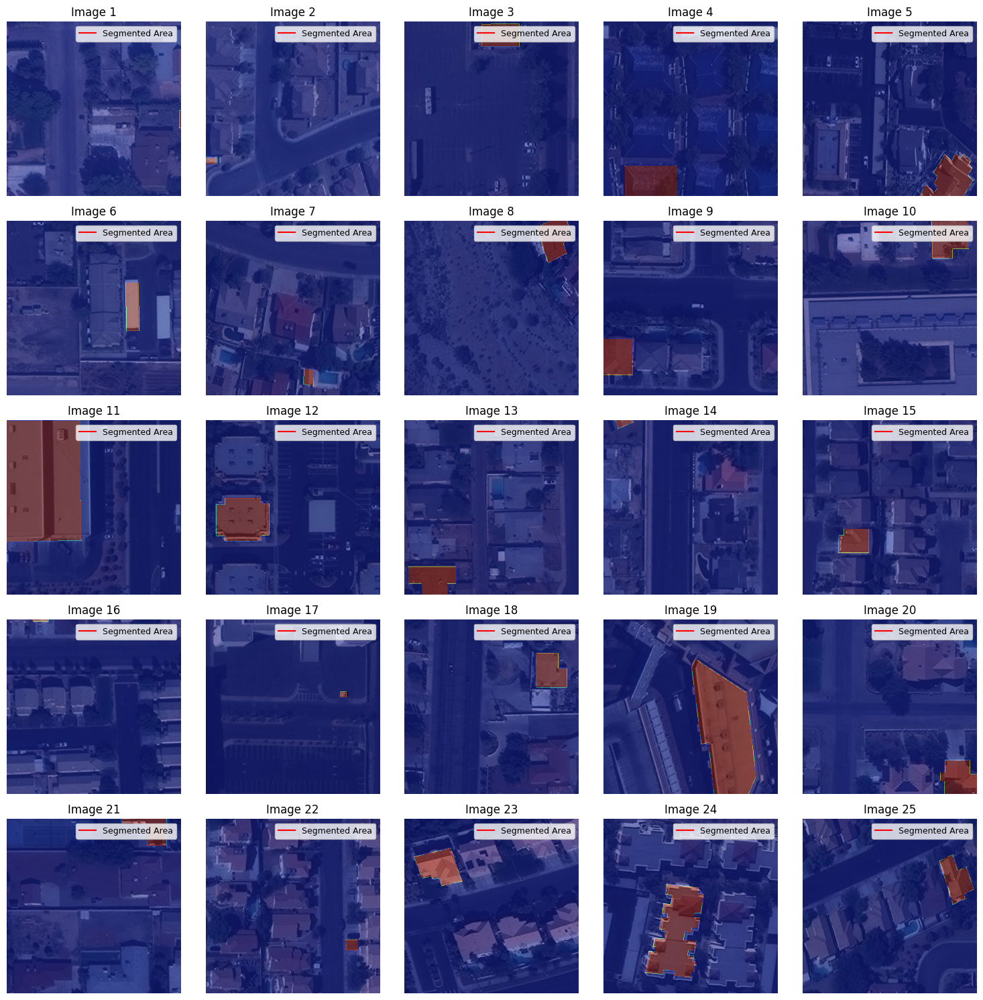

In [8]:
import numpy as np
import skimage.draw
import matplotlib.pyplot as plt
from skimage.io import imread

# Define function to convert polygons (segmentation) to a binary mask
def polygon_to_mask(image_shape, segmentation):
    """
    Convert polygon (segmentation) to a binary mask.

    Args:
    - image_shape: tuple (height, width) representing the image dimensions.
    - segmentation: list of polygon points (flattened coordinates).

    Returns:
    - mask: binary mask (1 for inside the polygon, 0 outside).
    """
    # Reshape the segmentation into an (n, 2) shape
    segmentation = np.array(segmentation).reshape((-1, 2))

    # Create a blank mask (image_shape should be (height, width))
    mask = np.zeros(image_shape, dtype=np.uint8)

    # Use skimage's polygon function to get the coordinates of the polygon
    rr, cc = skimage.draw.polygon(segmentation[:, 1], segmentation[:, 0], mask.shape)

    # Set the pixels inside the polygon to 1
    mask[rr, cc] = 1

    return mask

# Plot the first 25 images with their corresponding segmentation masks
fig, m_axs = plt.subplots(5, 5, figsize=(15, 15))  # 5x5 grid for 25 images
m_axs = m_axs.flatten()  # Flatten the axes array to make indexing easier

# Loop through the first 25 images in the DataFrame
for idx, (ax, (_, row)) in enumerate(zip(m_axs, full_df.head(25).iterrows())):
    # Get the segmentation points (if available)
    if isinstance(row['segmentation'], list):
        # Get the image size (height and width)
        img_size = (row['height'], row['width'])

        # Convert polygon to binary mask
        mask = polygon_to_mask(img_size, row['segmentation'])

        # Load the image
        img_data = imread(os.path.join(images_dir, row['file_name']))

        # Display the image
        ax.imshow(img_data)

        # Overlay the mask with transparency (alpha=0.5)
        ax.imshow(mask, alpha=0.5, cmap='jet')  # Overlay the mask on the image

        # Add a title or label with the image index or some information
        ax.set_title(f"Image {idx + 1}")
        ax.axis('off')

        # Add legend for the mask with red color
        ax.plot([], [], color='red', label='Segmented Area')  # Changed the color to red
        ax.legend(loc='upper right', fontsize=9)

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


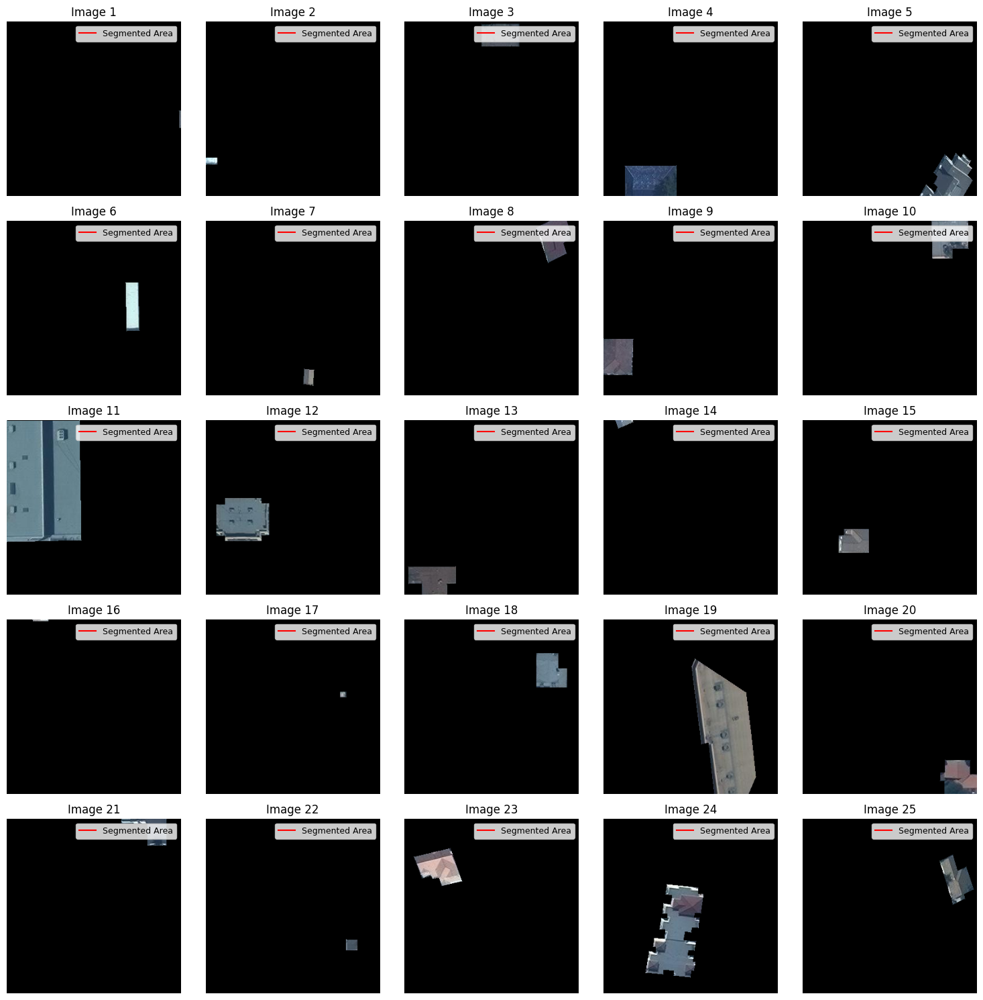

In [9]:
import numpy as np
import skimage.draw
import matplotlib.pyplot as plt
from skimage.io import imread

# Define function to convert polygons (segmentation) to a binary mask
def polygon_to_mask(image_shape, segmentation):
    """
    Convert polygon (segmentation) to a binary mask.

    Args:
    - image_shape: tuple (height, width) representing the image dimensions.
    - segmentation: list of polygon points (flattened coordinates).

    Returns:
    - mask: binary mask (1 for inside the polygon, 0 outside).
    """
    # Reshape the segmentation into an (n, 2) shape
    segmentation = np.array(segmentation).reshape((-1, 2))

    # Create a blank mask (image_shape should be (height, width))
    mask = np.zeros(image_shape, dtype=np.uint8)

    # Use skimage's polygon function to get the coordinates of the polygon
    rr, cc = skimage.draw.polygon(segmentation[:, 1], segmentation[:, 0], mask.shape)

    # Set the pixels inside the polygon to 1
    mask[rr, cc] = 1

    return mask

# Plot the first 25 images with their corresponding segmentation masks (no background, just segmentation)
fig, m_axs = plt.subplots(5, 5, figsize=(15, 15))  # 5x5 grid for 25 images
m_axs = m_axs.flatten()  # Flatten the axes array to make indexing easier

# Loop through the first 25 images in the DataFrame
for idx, (ax, (_, row)) in enumerate(zip(m_axs, full_df.head(25).iterrows())):
    # Get the segmentation points (if available)
    if isinstance(row['segmentation'], list):
        # Get the image size (height and width)
        img_size = (row['height'], row['width'])

        # Convert polygon to binary mask
        mask = polygon_to_mask(img_size, row['segmentation'])

        # Load the image
        img_data = imread(os.path.join(images_dir, row['file_name']))

        # Display the image
        ax.imshow(img_data)

        # Create a color mask for the segmented area (showing only the segmented region)
        segmented_area = np.zeros_like(img_data)
        segmented_area[mask == 1] = img_data[mask == 1]  # Only show segmented area on top of the real image

        # Display the image with the segmented area
        ax.imshow(segmented_area, alpha=1)  # Display segmented area on the original image

        # Add a title or label with the image index or some information
        ax.set_title(f"Image {idx + 1}")
        ax.axis('off')

        # Add legend for the mask with red color
        ax.plot([], [], color='red', label='Segmented Area')  # Change color to red for the legend
        ax.legend(loc='upper right', fontsize=9)

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


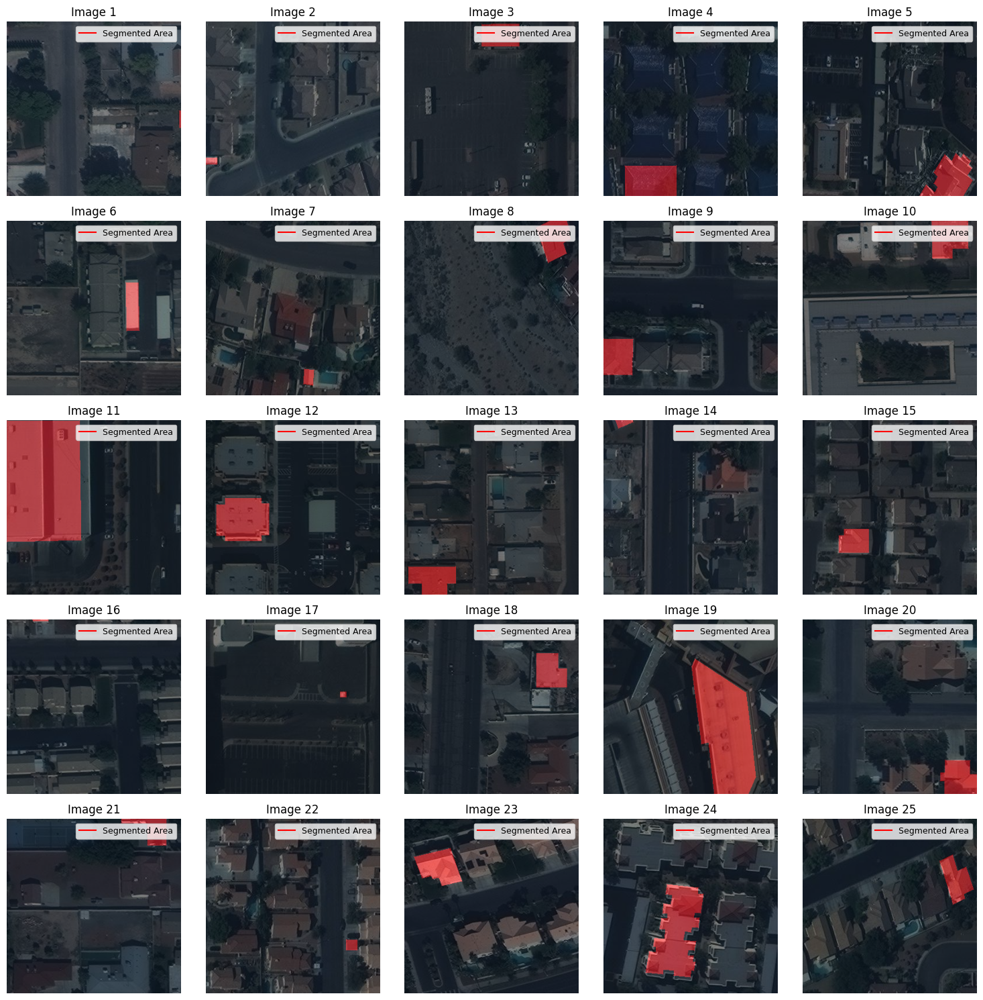

In [10]:
import numpy as np
import skimage.draw
import matplotlib.pyplot as plt
from skimage.io import imread

# Define function to convert polygons (segmentation) to a binary mask
def polygon_to_mask(image_shape, segmentation):
    """
    Convert polygon (segmentation) to a binary mask.

    Args:
    - image_shape: tuple (height, width) representing the image dimensions.
    - segmentation: list of polygon points (flattened coordinates).

    Returns:
    - mask: binary mask (1 for inside the polygon, 0 outside).
    """
    # Reshape the segmentation into an (n, 2) shape
    segmentation = np.array(segmentation).reshape((-1, 2))

    # Create a blank mask (image_shape should be (height, width))
    mask = np.zeros(image_shape, dtype=np.uint8)

    # Use skimage's polygon function to get the coordinates of the polygon
    rr, cc = skimage.draw.polygon(segmentation[:, 1], segmentation[:, 0], mask.shape)

    # Set the pixels inside the polygon to 1
    mask[rr, cc] = 1

    return mask

# Plot the first 25 images with their corresponding segmentation masks (only red segmentation)
fig, m_axs = plt.subplots(5, 5, figsize=(15, 15))  # 5x5 grid for 25 images
m_axs = m_axs.flatten()  # Flatten the axes array to make indexing easier

# Loop through the first 25 images in the DataFrame
for idx, (ax, (_, row)) in enumerate(zip(m_axs, full_df.head(25).iterrows())):
    # Get the segmentation points (if available)
    if isinstance(row['segmentation'], list):
        # Get the image size (height and width)
        img_size = (row['height'], row['width'])

        # Convert polygon to binary mask
        mask = polygon_to_mask(img_size, row['segmentation'])

        # Load the image
        img_data = imread(os.path.join(images_dir, row['file_name']))

        # Display the original image
        ax.imshow(img_data)

        # Create a red-colored mask for the segmented area
        red_segmented_area = np.zeros_like(img_data)
        red_segmented_area[mask == 1] = [255, 0, 0]  # Set the segmented area to red (RGB: [255, 0, 0])

        # Overlay the red segmented area on top of the original image with transparency
        ax.imshow(red_segmented_area, alpha=0.5)  # Use alpha to adjust transparency for red overlay

        # Add a title or label with the image index or some information
        ax.set_title(f"Image {idx + 1}")
        ax.axis('off')

        # Add legend for the mask with red color
        ax.plot([], [], color='red', label='Segmented Area')  # Red for the legend
        ax.legend(loc='upper right', fontsize=9)

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


In [11]:
# Function to convert rows to segmentation mask
def rows_to_segmentation(img_data, c_df):
    img_shape = img_data.shape[:2]  # Get height and width from image data
    segmentation_mask = np.zeros(img_shape, dtype=np.uint8)  # Initialize empty mask

    for _, row in c_df.iterrows():  # Iterate through each row in the DataFrame
        if isinstance(row['segmentation'], list):  # Check if segmentation data is present
            mask = polygon_to_mask(img_shape, row['segmentation'])  # Convert polygon to mask
            segmentation_mask = np.maximum(segmentation_mask, mask)  # Combine all masks

    return segmentation_mask

In [12]:
# Check if images are being loaded correctly
for i in range(10):  # Check the first 10 image paths
    print(image_paths[i])


/root/.cache/kagglehub/datasets/kmader/synthetic-word-ocr/versions/1/train/images/000000239047.jpg
/root/.cache/kagglehub/datasets/kmader/synthetic-word-ocr/versions/1/train/images/000000037213.jpg
/root/.cache/kagglehub/datasets/kmader/synthetic-word-ocr/versions/1/train/images/000000115886.jpg
/root/.cache/kagglehub/datasets/kmader/synthetic-word-ocr/versions/1/train/images/000000135786.jpg
/root/.cache/kagglehub/datasets/kmader/synthetic-word-ocr/versions/1/train/images/000000075474.jpg
/root/.cache/kagglehub/datasets/kmader/synthetic-word-ocr/versions/1/train/images/000000246332.jpg
/root/.cache/kagglehub/datasets/kmader/synthetic-word-ocr/versions/1/train/images/000000000431.jpg
/root/.cache/kagglehub/datasets/kmader/synthetic-word-ocr/versions/1/train/images/000000179552.jpg
/root/.cache/kagglehub/datasets/kmader/synthetic-word-ocr/versions/1/train/images/000000029947.jpg
/root/.cache/kagglehub/datasets/kmader/synthetic-word-ocr/versions/1/train/images/000000275568.jpg


ONE batch

2385532 training boxes
2195247 validation boxes
x (8, 300, 300, 3) float64 0.0 1.0
y (8, 300, 300, 1) uint8 0 1


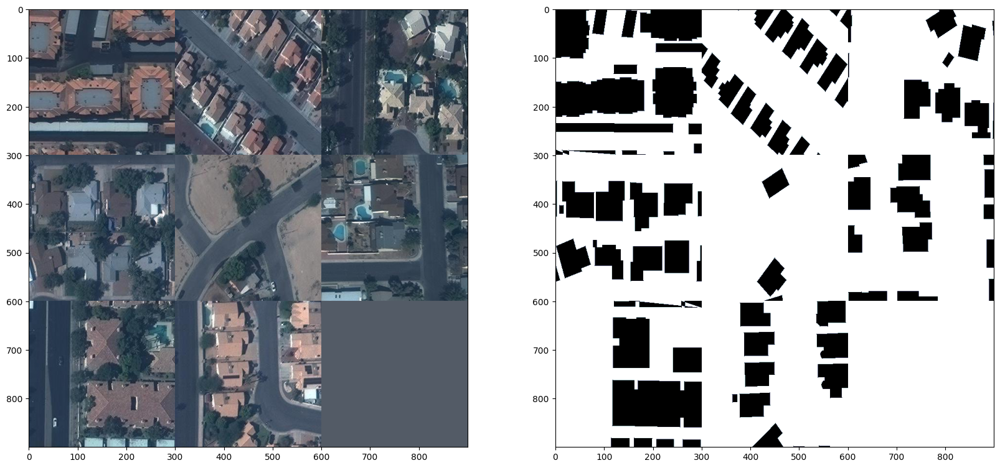

In [13]:
import os
import numpy as np
from skimage.io import imread
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

map_img_dir = '/root/.cache/kagglehub/datasets/kmader/synthetic-word-ocr/versions/1/train/images'

# Assuming 'full_df' is already defined and contains the necessary data
# Create training and validation datasets using train_test_split
train_ids, valid_ids = train_test_split(full_df['image_id'], test_size=0.25)
train_df = full_df[full_df['image_id'].isin(train_ids)]
valid_df = full_df[full_df['image_id'].isin(valid_ids)]
print(train_df.shape[0], 'training boxes')
print(valid_df.shape[0], 'validation boxes')

def batch_img_gen(in_df, batch_size):
    all_groups = list(in_df.groupby('image_id'))  # Group data by 'image_id'
    out_img, out_seg, out_timesteps = [], [], []

    while True:
        np.random.shuffle(all_groups)  # Shuffle the groups of images
        for _, c_df in all_groups:  # Iterate through each group
            img_path = os.path.join(map_img_dir, c_df['file_name'].values[0])  # Get image path
            if not os.path.exists(img_path):  # Check if image exists
                print(f"Warning: Image {img_path} not found, skipping...")
                continue

            img_data = imread(img_path)  # Read image
            timesteps = np.array([0])  # Define the timestep (you can replace this with real time data if available)

            out_img.append(img_data)
            out_seg.append(np.expand_dims(rows_to_segmentation(img_data, c_df), -1))  # Create segmentation mask
            out_timesteps.append(timesteps)  # Add timestep information

            if len(out_img) >= batch_size:  # If batch is full, yield the data
                yield (
                    np.stack(out_img, 0) / 255.0,  # Image data
                    np.stack(out_seg, 0)  # Segmentation masks
                )
                out_img, out_seg, out_timesteps = [], [], []  # Reset after yielding a batch

# Generate a batch for validation after defining valid_df
valid_gen = batch_img_gen(valid_df, 8)
t_x, t_y = next(valid_gen)
print('x', t_x.shape, t_x.dtype, t_x.min(), t_x.max())
print('y', t_y.shape, t_y.dtype, t_y.min(), t_y.max())

# Plot the images and corresponding segmentation masks
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))

# Assuming montage function is defined to combine images in a way suitable for display
montage_rgb = lambda x: np.stack([montage(x[:, :, :, i]) for i in range(x.shape[3])], -1)
ax1.imshow(montage_rgb(t_x))  # Display the images
ax2.imshow(montage(t_y[:, :, :, 0]), cmap='bone_r')

2nd Batch


In [14]:
import tensorflow as tf
from tensorflow.keras import layers, models, activations
import numpy as np

In [15]:
import tensorflow as tf
from tensorflow.keras import layers, models

# SinusoidalProjection Layer for Timestep Embedding
class SinusoidalProjection(layers.Layer):
    def __init__(self, embed_dim):
        super(SinusoidalProjection, self).__init__()
        self.embed_dim = embed_dim

    def call(self, timesteps):
        position = tf.expand_dims(timesteps, -1)
        div_term = tf.exp(tf.range(self.embed_dim // 2, dtype=tf.float32) * -(tf.math.log(10000.0) / self.embed_dim))
        sinusoidal_embed = tf.concat([tf.sin(position * div_term), tf.cos(position * div_term)], axis=-1)
        return sinusoidal_embed

# VAE Encoder
def vae_encoder(input_shape, latent_dim):
    inputs = layers.Input(shape=input_shape)
    x = layers.Conv2D(16, (3, 3), activation='relu', padding='same')(inputs)
    x = layers.MaxPooling2D((2, 2))(x)
    x = layers.Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = layers.MaxPooling2D((2, 2))(x)
    x = layers.Flatten()(x)
    z_mean = layers.Dense(latent_dim, name="z_mean")(x)
    z_log_var = layers.Dense(latent_dim, name="z_log_var")(x)
    return models.Model(inputs, [z_mean, z_log_var], name="vae_encoder")

# Sampling Layer
class Sampling(layers.Layer):
    def call(self, inputs):
        z_mean, z_log_var = inputs
        epsilon = tf.keras.backend.random_normal(shape=tf.shape(z_mean))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon


# VAE Decoder
def vae_decoder(latent_dim, output_shape, num_classes):
    latent_inputs = layers.Input(shape=(latent_dim,))

    target_height, target_width, _ = output_shape  # Unpack the first two dimensions (height, width)
    intermediate_height = target_height // 4
    intermediate_width = target_width // 4
    intermediate_channels = 16

    flattened_dim = intermediate_height * intermediate_width * intermediate_channels
    x = layers.Dense(flattened_dim, activation='relu')(latent_inputs)
    x = layers.Reshape((intermediate_height, intermediate_width, intermediate_channels))(x)

    # Upsample layers to match output shape
    x = layers.Conv2DTranspose(16, (3, 3), activation='relu', padding='same')(x)
    x = layers.UpSampling2D((2, 2))(x)  # Upsample to (600, 600)
    x = layers.Conv2DTranspose(16, (3, 3), activation='relu', padding='same')(x)
    x = layers.UpSampling2D((2, 2))(x)  # Upsample to (1200, 1200)

    # Final convolution to match the output size (300, 300, num_classes)
    x = layers.Conv2DTranspose(num_classes, (3, 3), activation='softmax', padding='same')(x)  # Output (300, 300, 5)

    return models.Model(latent_inputs, x, name="vae_decoder")
# Custom Layer to Handle Timestep Embedding and Squeeze
class TimestepEmbedding(layers.Layer):
    def __init__(self, embed_dim):
        super(TimestepEmbedding, self).__init__()
        self.embed_dim = embed_dim
        self.sinusoidal_projection = SinusoidalProjection(embed_dim)

    def call(self, timesteps):
        timestep_embeddings = self.sinusoidal_projection(timesteps)
        # Ensure that the output shape matches what is expected
        return tf.squeeze(timestep_embeddings, axis=1)  # Shape: (None, 16)

# Lightweight Diffusion Model with Fixed Timestep Embedding
def lightweight_diffusion_model(input_shape, latent_dim, num_classes):
    image_inputs = layers.Input(shape=input_shape)
    timesteps = layers.Input(shape=(1,))

    # Timestep Embedding (using the custom TimestepEmbedding layer)
    timestep_embeddings = TimestepEmbedding(embed_dim=16)(timesteps)

    # VAE Encoder
    encoder = vae_encoder(input_shape, latent_dim)
    z_mean, z_log_var = encoder(image_inputs)
    z = Sampling()([z_mean, z_log_var])

    # Add timestep embedding to latent space
    combined = layers.Concatenate()([z, timestep_embeddings])  # Concatenate the latent variable and timestep embedding

    # Decoder
    decoder = vae_decoder(latent_dim + 16, input_shape, num_classes)
    reconstructed_image = decoder(combined)

    # Classification Head
    classification_output = layers.Dense(num_classes, activation='softmax', name='classification_output')(z_mean)

    return models.Model(
        inputs=[image_inputs, timesteps],
        outputs=[reconstructed_image, classification_output],
        name="lightweight_diffusion_model"
    )

# Build and Compile the Model
input_shape = (300, 300, 3)  # Image size
latent_dim = 32
num_classes = 5

# Build the model
model = lightweight_diffusion_model(input_shape, latent_dim, num_classes)

# Compile the model
model.compile(
    optimizer='adam',
    loss={
        'vae_decoder': 'sparse_categorical_crossentropy',  # For the reconstructed image (segmentation)
        'classification_output': 'sparse_categorical_crossentropy'  # For the classification output
    },
    metrics={
        'vae_decoder': 'accuracy',
        'classification_output': 'accuracy'
    }
)


# Display Model Summary
model.summary()

Model: "lightweight_diffusion_model"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 300, 300, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ vae_encoder (Functional)  │ [(None, 32), (None,    │     11,525,152 │ input_layer[0][0]      │
│                           │ 32)]                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ input_layer_1             │ (None, 1)              │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sampling (Sampling)       │ (None, 32)             │              0 │ vae_encoder[0][0],     │
│                           │                        │                │ vae_encoder[0][1]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ timestep_embedding        │ (None, 16)             │              0 │ input_layer_1[0][0]    │
│ (TimestepEmbedding)       │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate (Concatenate) │ (None, 48)             │              0 │ sampling[0][0],        │
│                           │                        │                │ timestep_embedding[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ vae_decoder (Functional)  │ (None, 300, 300, 5)    │      4,415,365 │ concatenate[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ classification_output     │ (None, 5)              │            165 │ vae_encoder[0][0]      │
│ (Dense)                   │                        │                │                        │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 15,940,682 (60.81 MB)

 Trainable params: 15,940,682 (60.81 MB)

 Non-trainable params: 0 (0.00 B)

In [38]:
import pandas as pd
import os

# Specify the directory containing your images
map_img_dir = '/root/.cache/kagglehub/datasets/kmader/synthetic-word-ocr/versions/1/train/images'

# List all image files in the directory
image_files = [f for f in os.listdir(map_img_dir) if f.endswith(('.png', '.jpg', '.jpeg'))]

# Create a DataFrame
image_df = pd.DataFrame({
    'image_id': range(len(image_files)),  # Assign a unique ID to each image
    'file_name': image_files  # List of image filenames
})

print(image_df.head())


   image_id         file_name
0         0  000000218104.jpg
1         1  000000035488.jpg
2         2  000000029965.jpg
3         3  000000197722.jpg
4         4  000000031504.jpg


In [30]:
import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D
from tensorflow.keras.models import Model
from skimage.io import imread
from sklearn.model_selection import train_test_split

# Define the dataset directory
map_img_dir = '/root/.cache/kagglehub/datasets/kmader/synthetic-word-ocr/versions/1/train/images'

# Helper function to create segmentation masks
def rows_to_segmentation(img_data, df_row):
    """Convert the rows into segmentation mask (dummy implementation)."""
    mask = np.zeros((img_data.shape[0], img_data.shape[1]), dtype=np.float32)
    x_start, y_start, width, height = 50, 50, 100, 100
    mask[y_start:y_start + height, x_start:x_start + width] = 1.0
    return mask

# Load a subset of the dataset
def load_dataset(image_df, max_samples=100):
    """Load a limited number of samples."""
    subset_df = image_df.head(max_samples)
    images, masks = [], []
    for _, row in subset_df.iterrows():
        img_path = os.path.join(map_img_dir, row['file_name'])
        if not os.path.exists(img_path):
            continue
        img_data = imread(img_path) / 255.0  # Normalize
        seg_mask = rows_to_segmentation(img_data, row)
        images.append(img_data)
        masks.append(np.expand_dims(seg_mask, -1))
    return np.array(images), np.array(masks)

# Load a subset of data
train_images, train_masks = load_dataset(image_df, max_samples=100)

# Split into training and validation
train_x, val_x, train_y, val_y = train_test_split(
    train_images, train_masks, test_size=0.2, random_state=42
)


In [31]:
# Build a lightweight segmentation model
def build_lightweight_model(input_shape):
    inputs = Input(shape=input_shape, name="Input_Layer")
    # Encoder
    x = Conv2D(8, (3, 3), activation='relu', padding='same')(inputs)
    x = MaxPooling2D((2, 2))(x)
    x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2))(x)
    # Bottleneck
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    # Decoder
    x = UpSampling2D((2, 2))(x)
    x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D((2, 2))(x)
    outputs = Conv2D(1, (3, 3), activation='sigmoid', padding='same', name="Output_Layer")(x)
    return Model(inputs, outputs, name="Lightweight_Segmentation_Model")

# Instantiate and compile the model
input_shape = train_x.shape[1:]  # Use the shape of the input images
model = build_lightweight_model(input_shape)
model.compile(optimizer="adam", loss="binary_crossentropy", metrics=["accuracy"])
model.summary()

Model: "Lightweight_Segmentation_Model"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ Input_Layer (InputLayer)             │ (None, 300, 300, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_31 (Conv2D)                   │ (None, 300, 300, 8)         │             224 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_9 (MaxPooling2D)       │ (None, 150, 150, 8)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_32 (Conv2D)                   │ (None, 150, 150, 16)        │           1,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_10 (MaxPooling2D)      │ (None, 75, 75, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_33 (Conv2D)                   │ (None, 75, 75, 32)          │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_10 (UpSampling2D)      │ (None, 150, 150, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_34 (Conv2D)                   │ (None, 150, 150, 16)        │           4,624 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_11 (UpSampling2D)      │ (None, 300, 300, 16)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ Output_Layer (Conv2D)                │ (None, 300, 300, 1)         │             145 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 10,801 (42.19 KB)

 Trainable params: 10,801 (42.19 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 14s 1s/step - accuracy: 0.7331 - loss: 0.6603 - val_accuracy: 0.8889 - val_loss: 0.4761
Epoch 2/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 12s 1s/step - accuracy: 0.8889 - loss: 0.4194 - val_accuracy: 0.8889 - val_loss: 0.3889
Epoch 3/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 20s 1s/step - accuracy: 0.8889 - loss: 0.3812 - val_accuracy: 0.8889 - val_loss: 0.3793
Epoch 4/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 21s 1s/step - accuracy: 0.8889 - loss: 0.3773 - val_accuracy: 0.8889 - val_loss: 0.3663
Epoch 5/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 20s 1s/step - accuracy: 0.8889 - loss: 0.3625 - val_accuracy: 0.8889 - val_loss: 0.3632
Epoch 6/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 10s 1s/step - accuracy: 0.8889 - loss: 0.3614 - val_accuracy: 0.8889 - val_loss: 0.3591
Epoch 7/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 12s 1s/step - accuracy: 0.8889 - loss: 0.3544 - val_accuracy: 0.8889 - val_loss: 0.3549
Epoch 8/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 22s 1s/step - accuracy: 0.8889 - loss: 0.3515 - val_accuracy: 0.8889 - val_loss:

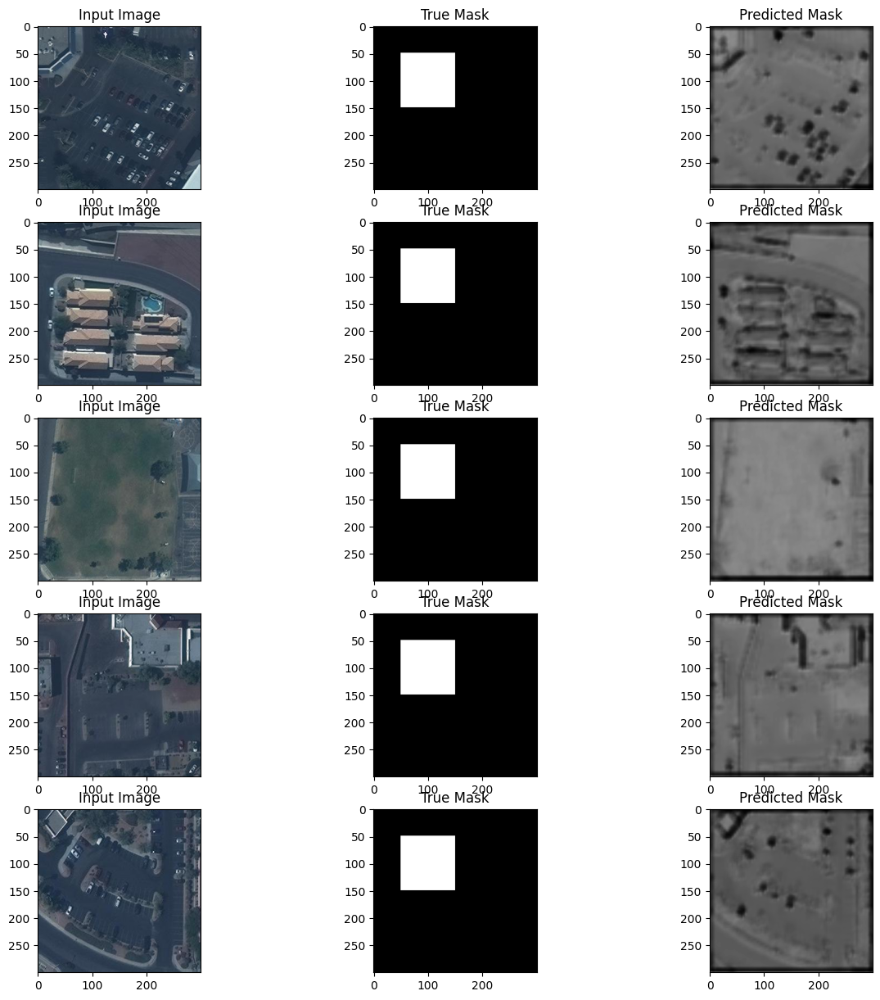

In [32]:
# Train the model
history = model.fit(
    train_x, train_y,
    validation_data=(val_x, val_y),
    epochs=10,
    batch_size=8,
    verbose=1
)

# Test the model
def plot_results(model, x_data, y_data, n_samples=5):
    preds = model.predict(x_data[:n_samples])
    fig, axes = plt.subplots(n_samples, 3, figsize=(15, 15))
    for i in range(n_samples):
        axes[i, 0].imshow(x_data[i])
        axes[i, 0].set_title("Input Image")
        axes[i, 1].imshow(y_data[i, :, :, 0], cmap="gray")
        axes[i, 1].set_title("True Mask")
        axes[i, 2].imshow(preds[i, :, :, 0], cmap="gray")
        axes[i, 2].set_title("Predicted Mask")
    plt.show()

# Visualize some predictions
plot_results(model, val_x, val_y)

In [33]:
import os
import numpy as np
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (
    Input, GaussianNoise, BatchNormalization, Conv2D, Activation, SpatialDropout2D,
    Cropping2D, ZeroPadding2D, Concatenate
)
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from sklearn.model_selection import train_test_split
from skimage.io import imread
from skimage.transform import resize

# Dataset path and checkpoint path
dataset_path = "/root/.cache/kagglehub/datasets/kmader/synthetic-word-ocr/versions/1/train/images"
model_checkpoint_path = "/content/model_checkpoint"

# Ensure the directory exists for saving the model
os.makedirs(model_checkpoint_path, exist_ok=True)

# Load a reduced dataset (100 images)
def load_dataset(dataset_dir, target_size=(300, 300), max_samples=100):
    images, masks = [], []
    for idx, file_name in enumerate(os.listdir(dataset_dir)):
        if idx >= max_samples:
            break
        img_path = os.path.join(dataset_dir, file_name)
        if not os.path.isfile(img_path):
            continue
        # Load and preprocess image
        img = imread(img_path)
        img = resize(img, target_size, mode="reflect", anti_aliasing=True)
        mask = np.zeros(target_size)  # Dummy mask, update this logic for real segmentation
        mask[50:150, 50:150] = 1  # Example mask, replace with proper segmentation logic
        images.append(img)
        masks.append(mask)
    images = np.array(images) / 255.0  # Normalize images
    masks = np.expand_dims(np.array(masks), axis=-1)  # Add channel dimension to masks
    return images, masks

# Load the dataset
images, masks = load_dataset(dataset_path, max_samples=100)

# Split into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(images, masks, test_size=0.25, random_state=42)

In [34]:
def build_model(input_shape):
    inputs = Input(shape=input_shape, name="RGB_Input")
    x = GaussianNoise(0.1)(inputs)
    x = BatchNormalization()(x)

    x = Conv2D(8, (3, 3), padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(8, (3, 3), padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(16, (3, 3), padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(16, (3, 3), padding="same")(x)
    convs = [Conv2D(16, (3, 3), padding="same")(x) for _ in range(6)]
    x = Concatenate()(convs + [inputs])

    x = SpatialDropout2D(0.2)(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(32, (3, 3), padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(1, (3, 3), padding="same")(x)
    x = Cropping2D(((16, 16), (16, 16)))(x)
    outputs = ZeroPadding2D(((16, 16), (16, 16)))(x)

    return Model(inputs, outputs)

# Build the model
model = build_model((300, 300, 3))
model.compile(optimizer="adam", loss="binary_crossentropy", metrics=["accuracy"])

model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ RGB_Input (InputLayer)    │ (None, 300, 300, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ gaussian_noise_1          │ (None, 300, 300, 3)    │              0 │ RGB_Input[0][0]        │
│ (GaussianNoise)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_12    │ (None, 300, 300, 3)    │             12 │ gaussian_noise_1[0][0] │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_35 (Conv2D)        │ (None, 300, 300, 8)    │            224 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_13    │ (None, 300, 300, 8)    │             32 │ conv2d_35[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_5 (Activation) │ (None, 300, 300, 8)    │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_36 (Conv2D)        │ (None, 300, 300, 8)    │            584 │ activation_5[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_14    │ (None, 300, 300, 8)    │             32 │ conv2d_36[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_6 (Activation) │ (None, 300, 300, 8)    │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_37 (Conv2D)        │ (None, 300, 300, 16)   │          1,168 │ activation_6[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_15    │ (None, 300, 300, 16)   │             64 │ conv2d_37[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_7 (Activation) │ (None, 300, 300, 16)   │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_38 (Conv2D)        │ (None, 300, 300, 16)   │          2,320 │ activation_7[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_39 (Conv2D)        │ (None, 300, 300, 16)   │          2,320 │ conv2d_38[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_40 (Conv2D)        │ (None, 300, 300, 16)   │          2,320 │ conv2d_38[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_41 (Conv2D)        │ (None, 300, 300, 16)   │          2,320 │ conv2d_38[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_42 (Conv2D)        │ (None, 300, 300, 16)   │          2,320 │ conv2d_38[0][0]        │
├──────────────────────

 Total params: 47,713 (186.38 KB)

 Trainable params: 47,381 (185.08 KB)

 Non-trainable params: 332 (1.30 KB)

In [36]:
# Set up callbacks
checkpoint = ModelCheckpoint(
    filepath=os.path.join(model_checkpoint_path, "best_model.keras"),  # Change extension to .keras
    monitor="val_loss",
    save_best_only=True,
    verbose=1
)
early_stopping = EarlyStopping(monitor="val_loss", patience=5, verbose=1)

# Train the model
history = model.fit(
    X_train, y_train,
    validation_data=(X_val, y_val),
    epochs=10,
    batch_size=8,
    callbacks=[checkpoint, early_stopping],
    verbose=1
)

# Save the final model
model.save(os.path.join(model_checkpoint_path, "final_model.keras"))  # Change extension to .keras


Epoch 1/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 13s/step - accuracy: 0.8752 - loss: 1.7269 
Epoch 1: val_loss improved from inf to 1.79090, saving model to /content/model_checkpoint/best_model.keras
10/10 ━━━━━━━━━━━━━━━━━━━━ 147s 14s/step - accuracy: 0.8754 - loss: 1.7272 - val_accuracy: 0.8889 - val_loss: 1.7909
Epoch 2/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 13s/step - accuracy: 0.8786 - loss: 1.7305 
Epoch 2: val_loss improved from 1.79090 to 0.36667, saving model to /content/model_checkpoint/best_model.keras
10/10 ━━━━━━━━━━━━━━━━━━━━ 144s 14s/step - accuracy: 0.8784 - loss: 1.7302 - val_accuracy: 0.8889 - val_loss: 0.3667
Epoch 3/10
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 13s/step - accuracy: 0.8597 - loss: 1.7451 
Epoch 3: val_loss improved from 0.36667 to 0.32556, saving model to /content/model_checkpoint/best_model.keras
10/10 ━━━━━━━━━━━━━━━━━━━━ 139s 14s/step - accuracy: 0.8597 - loss: 1.7454 - val_accuracy: 0.8889 - val_loss: 0.3256
Epoch 4/10
 9/10 ━━━━━━━━━━━━━━━━━━━━ 13s 14s/step - accuracy: 0.

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


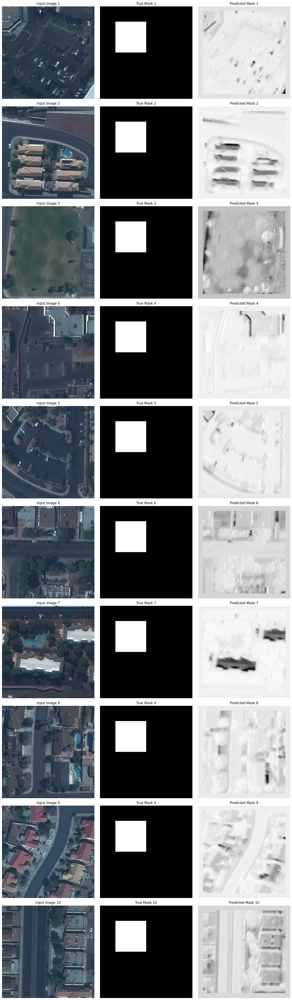

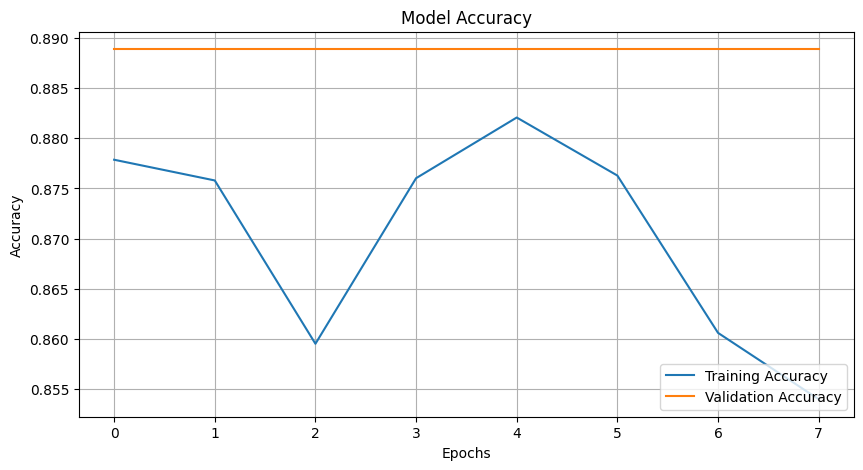

In [41]:
import matplotlib.pyplot as plt

# Test the model and plot results
def plot_results(model, x_data, y_data, n_samples=10):
    # Predict on the first n_samples images
    preds = model.predict(x_data[:n_samples])

    # Set up subplots for the images and masks
    fig, axes = plt.subplots(n_samples, 3, figsize=(15, 5 * n_samples))

    for i in range(n_samples):
        # Plot the input image
        axes[i, 0].imshow(x_data[i])
        axes[i, 0].set_title(f"Input Image {i+1}")
        axes[i, 0].axis('off')  # Hide axes

        # Plot the true mask
        axes[i, 1].imshow(y_data[i, :, :, 0], cmap="gray")
        axes[i, 1].set_title(f"True Mask {i+1}")
        axes[i, 1].axis('off')

        # Plot the predicted mask
        axes[i, 2].imshow(preds[i, :, :, 0], cmap="gray")
        axes[i, 2].set_title(f"Predicted Mask {i+1}")
        axes[i, 2].axis('off')

    # Tight layout to avoid overlap
    plt.tight_layout()

    # Show the plot
    plt.show()

# Visualize predictions for 10 images
plot_results(model, val_x, val_y, n_samples=10)

# Plot Training and Validation Accuracy
def plot_accuracy(history):
    plt.figure(figsize=(10, 5))
    plt.plot(history.history['accuracy'], label='Training Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title('Model Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend(loc='lower right')
    plt.grid(True)
    plt.show()

# Plot accuracy of the trained model
plot_accuracy(history)


In [42]:
from tensorflow.keras.layers import Softmax

# Build the model with softmax output for multi-class segmentation
def build_model(input_shape, num_classes=3):
    inputs = Input(shape=input_shape, name="RGB_Input")
    x = GaussianNoise(0.1)(inputs)
    x = BatchNormalization()(x)

    # Example architecture - add more layers as needed
    x = Conv2D(32, (3, 3), padding="same")(x)
    x = Activation("relu")(x)
    x = Conv2D(32, (3, 3), padding="same")(x)
    x = Activation("relu")(x)

    x = Conv2D(num_classes, (3, 3), padding="same")(x)  # num_classes as output channels
    outputs = Softmax()(x)  # Softmax activation for multi-class classification

    return Model(inputs, outputs)

# Update model with the appropriate number of classes
num_classes = 3  # Change based on your dataset
model = build_model((300, 300, 3), num_classes=num_classes)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 808ms/step


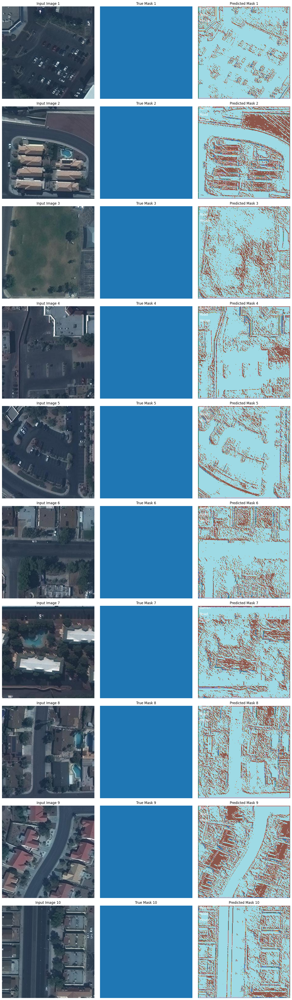

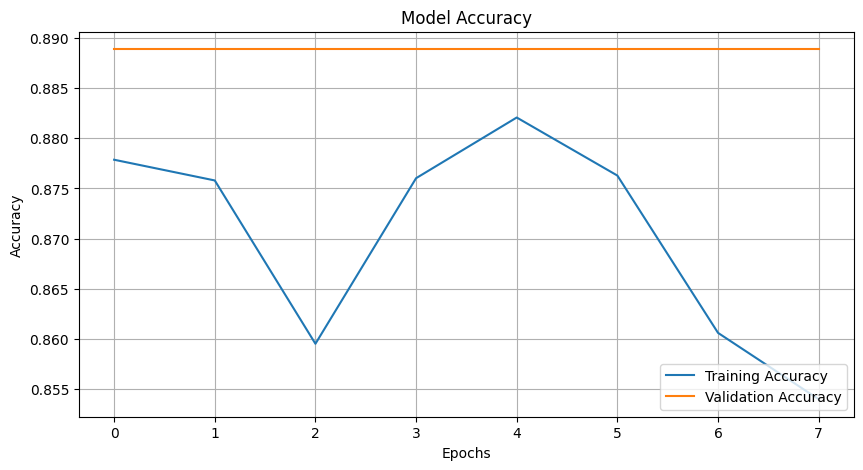

In [44]:
# Class labels for your classes (modify based on your dataset)
class_labels = {0: "Barren", 1: "Road", 2: "House"}

# Function to map the predicted class index to a class label
def decode_prediction(pred):
    return np.argmax(pred, axis=-1)  # Get the index of the max probability for each pixel

# Test the model and plot results
def plot_results(model, x_data, y_data, n_samples=10):
    # Predict on the first n_samples images
    preds = model.predict(x_data[:n_samples])

    # Set up subplots for the images and masks
    fig, axes = plt.subplots(n_samples, 3, figsize=(15, 5 * n_samples))

    for i in range(n_samples):
        # Plot the input image
        axes[i, 0].imshow(x_data[i])
        axes[i, 0].set_title(f"Input Image {i+1}")
        axes[i, 0].axis('off')  # Hide axes

        # Plot the true mask
        true_mask = np.argmax(y_data[i, :, :, :], axis=-1)  # Assuming y_data has one-hot encoding
        axes[i, 1].imshow(true_mask, cmap="tab20")  # Use a colormap for class labels
        axes[i, 1].set_title(f"True Mask {i+1}")
        axes[i, 1].axis('off')

        # Plot the predicted mask with class labels
        pred_mask = decode_prediction(preds[i])  # Get predicted class labels
        axes[i, 2].imshow(pred_mask, cmap="tab20")  # Use a colormap for class labels
        axes[i, 2].set_title(f"Predicted Mask {i+1}")
        axes[i, 2].axis('off')

        # Add class names as text labels to the predicted masks
        for j in range(len(class_labels)):
            axes[i, 2].text(5, 10 + j * 20, f"{class_labels[j]}", color='white', fontsize=12, ha="left")

    plt.tight_layout()  # Ensure the subplots don't overlap
    plt.show()

# Visualize predictions for 10 images
plot_results(model, val_x, val_y, n_samples=10)

# Plot Training and Validation Accuracy
def plot_accuracy(history):
    plt.figure(figsize=(10, 5))
    plt.plot(history.history['accuracy'], label='Training Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title('Model Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend(loc='lower right')
    plt.grid(True)
    plt.show()

# Plot accuracy of the trained model
plot_accuracy(history)